## Changes compared to previous submit
1. The calculation of the offset has been corrected such that the offset from the center of lane is correct. As noted, with division by 2. See the line "lane_offset = (leftLane.line_base_pos + rightLane.line_base_pos)/2" in methog "process_image(image)".
2. The mapping has been chenged so that the lane becomes half as wide and thereby, all curvatures become visible. See the method "getSourceDestination(image)"
3. To find the right lane lines, the search is limited arounf the previous lane midline. Also between two windows, large jumps in the center of the window are avoided. See method "find_lane_pixels_by_boxing(warpedBinary, midLaneLine)".

Note that I use sliding windows for search of right window. It is more expensive, but I found it more reliable during the course of the work.

## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

## Importing necessary libraries

In [1]:
import numpy as np
import cv2
import os
import glob
import pickle
import math
from matplotlib import pyplot as plt
%matplotlib qt

## Utility functions for later simplification
First, I have a section for ividing the videos to frames. This is only done for testing of the algorithms for some difficult frames. To have that done, the variable "for_development" should be set to true.

In [2]:
"""
    This cell should be executed only if frames from the videos are needed during development
    work. To do that, set for_development to True.
"""

for_development = False

if (for_development):
    for f_name in ["project_video", "challenge_video", "harder_challenge_video"]:
        print("--- Checking for ", f_name, " ---")
        if (not os.path.exists('./' + f_name + "_frames")):
            os.mkdir(f_name + "_frames")
            print(f_name + " created...")
            vidcap = cv2.VideoCapture(f_name + '.mp4')
            success,image = vidcap.read()
            count = 0
            print('Creating frames.')
            while success:
                cv2.imwrite(f_name + "_frames/frame%d.jpg" % count, image)     # save frame as JPEG file      
                success,image = vidcap.read()
                count += 1
                print('.', end='')
                if ((count % 50 == 0)): print("- ", count, " -")
        else:
            print("The directory ", f_name + "_frames exists.")
            print("To generate frames, please remove the directory.")
else:
    print("No action is taken!")

No action is taken!


The following is a section with some utility function for simple calls.

In [3]:
# These functions are taken from the course or previous lab and are only changed minimally to make the calling simpler
def weighted_img(img, initial_img, a=0.8, b=1., g=0.):
    return cv2.addWeighted(initial_img, a, img, b, g)

def undistortImage(img, cameraCalData):
    return cv2.undistort(img, cameraCalData["mtx"], cameraCalData["dist"], None, cameraCalData["mtx"])

def warper(img, M):
    img_size = (img.shape[1], img.shape[0])
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_NEAREST)  # keep same size as input image
    return warped

def mask_region_of_interest(img, vertices):
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


## Camera calibration
First, I calibrate the camera. The method is given in the course lectures and quizes. I have only packed the function in a method that takes the directory with images and computes the distortion and transform matrix for the camera.

The input of the method is the number of corners in horizontal and vertical directions and the directory where the images can be found. First, the corner coordinates are found from each image and together with together with the coordinates on the "object" are collected. These are inputs to OpenCV's calibrateCamera method.

In [4]:
# Rearrangement of existing code to a single function that gets number of corner points
# in horizontal and vertical directions and the name of the files including regular expressions
# and returns camera matrix and distotion coefficients as a dictionary, or None if there are problems
def calibrateCamera(cornersNoHorizontal, cornersNoVertical, dirFileName):
    
    objp = np.zeros((cornersNoHorizontal*cornersNoVertical,3), np.float32)
    objp[:,:2] = np.mgrid[0:cornersNoHorizontal, 0:cornersNoVertical].T.reshape(-1,2)
    
    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.
    
    # Make a list of calibration images
    images = glob.glob(dirFileName)
    
    # Step through the list and search for chessboard corners
    for idx, fname in enumerate(images):
        img = cv2.imread(fname,1)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (cornersNoHorizontal,cornersNoVertical), None)
    
        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
    if (len(imgpoints) > 0):
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1],None,None)
        if (ret):
            camera = {}
            camera["dist"] = dist
            camera["mtx"] = mtx
            return camera
        else:
            return None
    else:
        print("No file with proper image found.")

The calibration data cannow  be computed:

In [5]:
cameraCalData = calibrateCamera(9, 6, "camera_cal/calibration*.jpg")
if (cameraCalData):
    print("Camera calibration completed. Data is stored in dictionary cameraCalData")
else:
    print("Calibration not complete.")

Camera calibration completed. Data is stored in dictionary cameraCalData


Now, the calibration is complete and data is stored in the global variable cameraCalData, with two elements:

* cameraCalData["mtx"] and 
* cameraCalData["dist"], 

which are camera matrix and distorsion coefficients, respectively.

To test that the calibration is correct, I test the result by undistording one of the images and thereafter warping it.

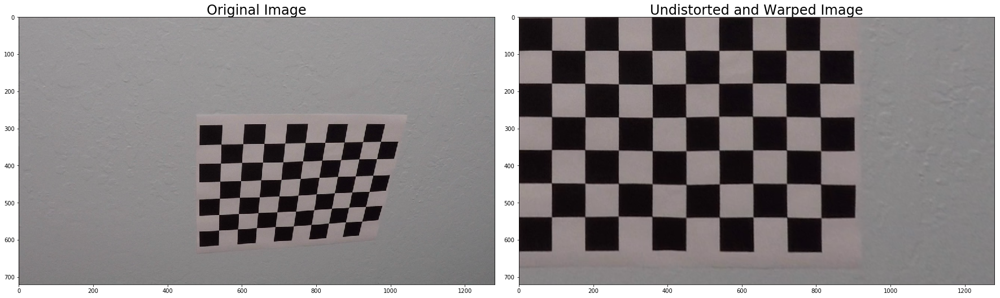

In [6]:
# The code is taken from the course. The steps are clear:
# 1. undstord the image, 2. find the corners and pick 4 as source points and set the corresponding destination points
# 3. unwarp the image.

img = cv2.imread('camera_cal/calibration10.jpg')
nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

# MODIFY THIS FUNCTION TO GENERATE OUTPUT 
# THAT LOOKS LIKE THE IMAGE ABOVE
def corners_unwarp(img, nx, ny, mtx, dist):
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undist, cv2.COLOR_BGR2GRAY)
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny), None)
    qsize = 90
    src = np.float32([corners[0,0,:],corners[nx-1,0,:],corners[nx*(ny-1),0,:],corners[nx*ny-1,0,:]])
    dst = np.float32([[qsize,qsize],[qsize+(nx-1)*qsize,qsize],\
                      [qsize,qsize+(ny-1)*qsize],[qsize+(nx-1)*qsize,qsize+(ny-1)*qsize]])
    M = cv2.getPerspectiveTransform(src, dst)
    warped = cv2.warpPerspective(undist, M, gray.shape[::-1], flags=cv2.INTER_LINEAR)
    return warped, M

top_down, perspective_M = corners_unwarp(img, nx, ny, cameraCalData["mtx"], cameraCalData["dist"])

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
fig.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=24)
ax2.imshow(top_down)
ax2.set_title('Undistorted and Warped Image', fontsize=24)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


Camera calibration is correct and images can be images can be undistorted and warped. It should be noted that during this process, the transformation matrix is also computed. I will need a similar transformation matrix for transforming the perspective to a bird-eye view. That can be done by considering a straight lane. Before doing that, I define following utility functions. All of these functions are taken from previous lab or quizes.

## Color transform, gradients and image thresholding
To start with, we have a look at test images in "test_images" directory.

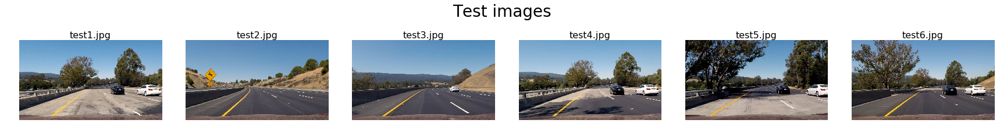

In [7]:
im_files = glob.glob("./test_images/test*")

fig, axes = plt.subplots(1,len(im_files), figsize=(24, 4))
fig.suptitle("Test images", fontsize=28)
fig.tight_layout()
for i in range(len(im_files)):
    img = plt.imread(im_files[i])
    axes[i].set_title(im_files[i][14:], fontdict={'fontsize': 16, 'fontweight': 'medium'})
    axes[i].axis('off')
    axes[i].imshow(img)

Special features of these images are:

* Test1: Dark patterns on the surface of the road.
* Test2: Right line is starting far away
* Test3: Relatively normal situation
* Test4: Varying sunlight and darker shadows on the road.
* Test5: Not so well visible lines and tree shadows
* Test6: Less visible right line

I start by looking at these images in different color spaces:

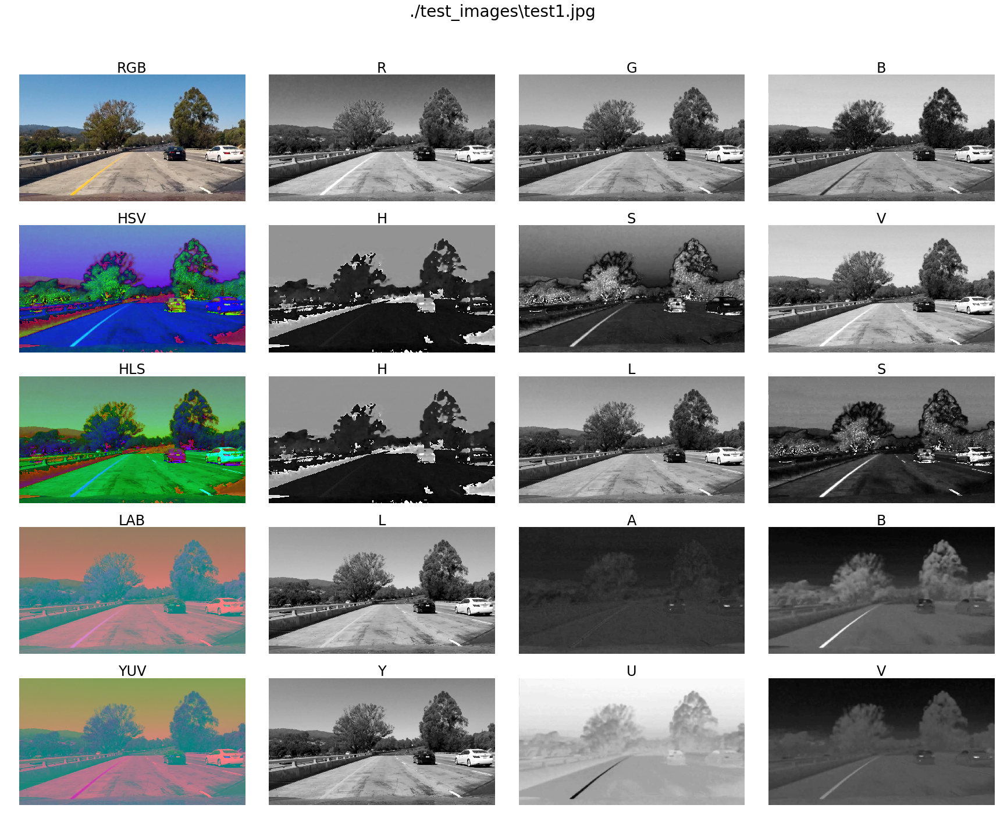

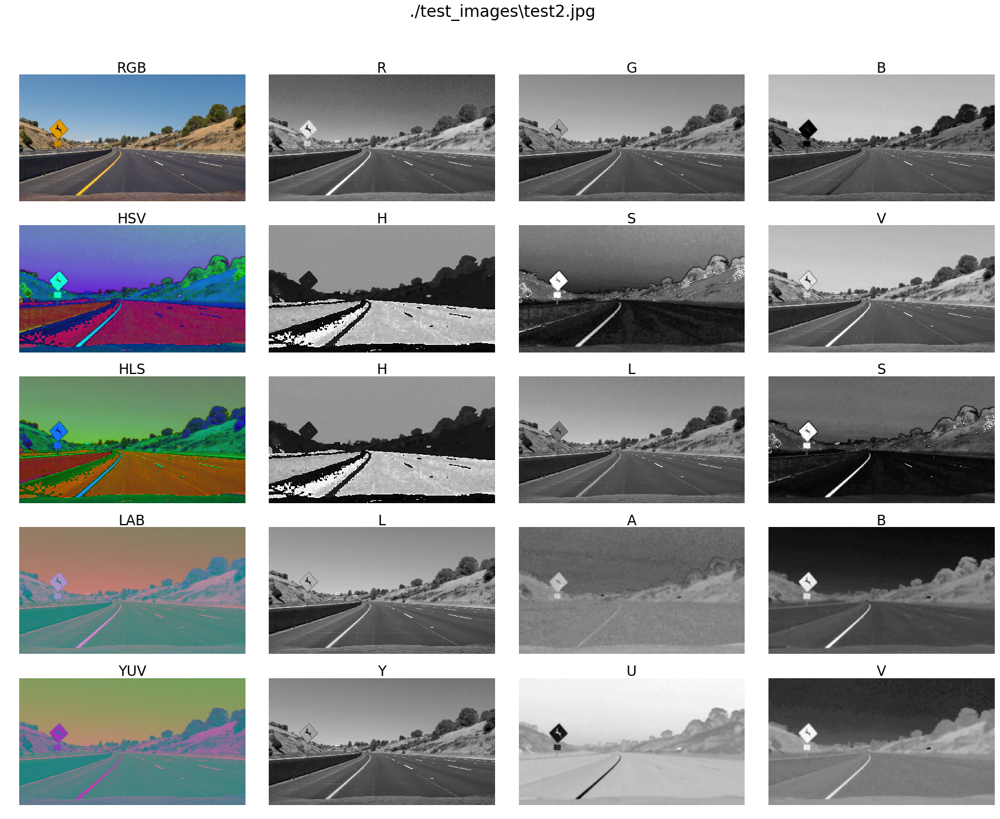

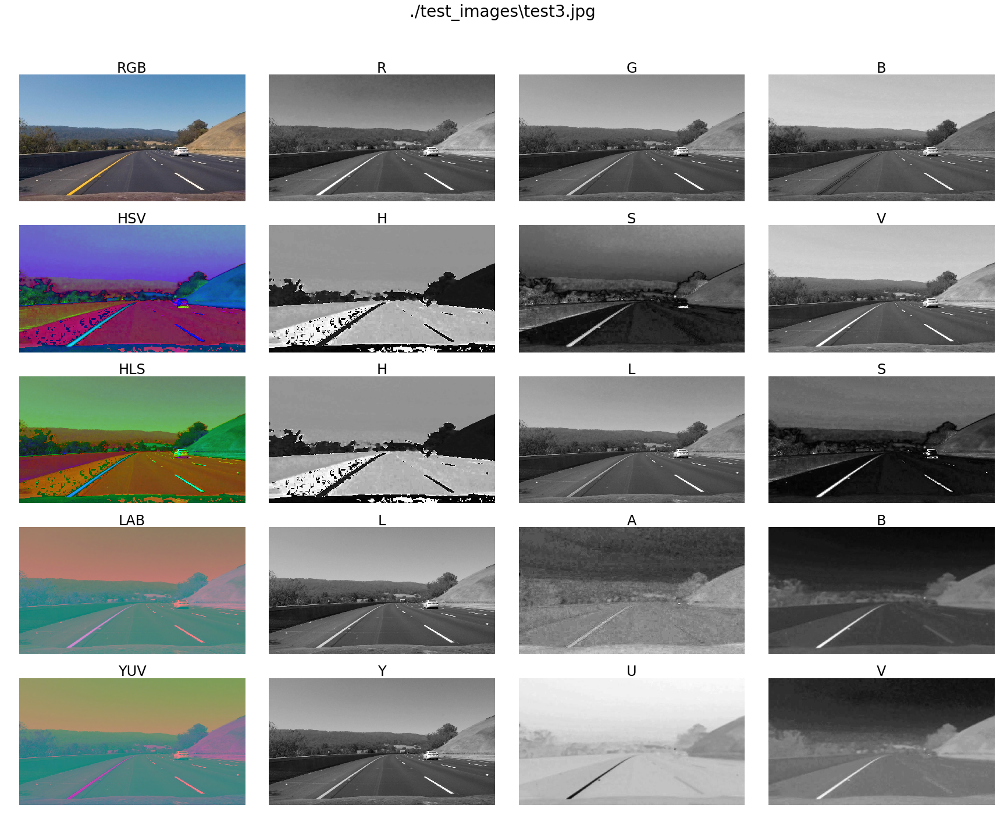

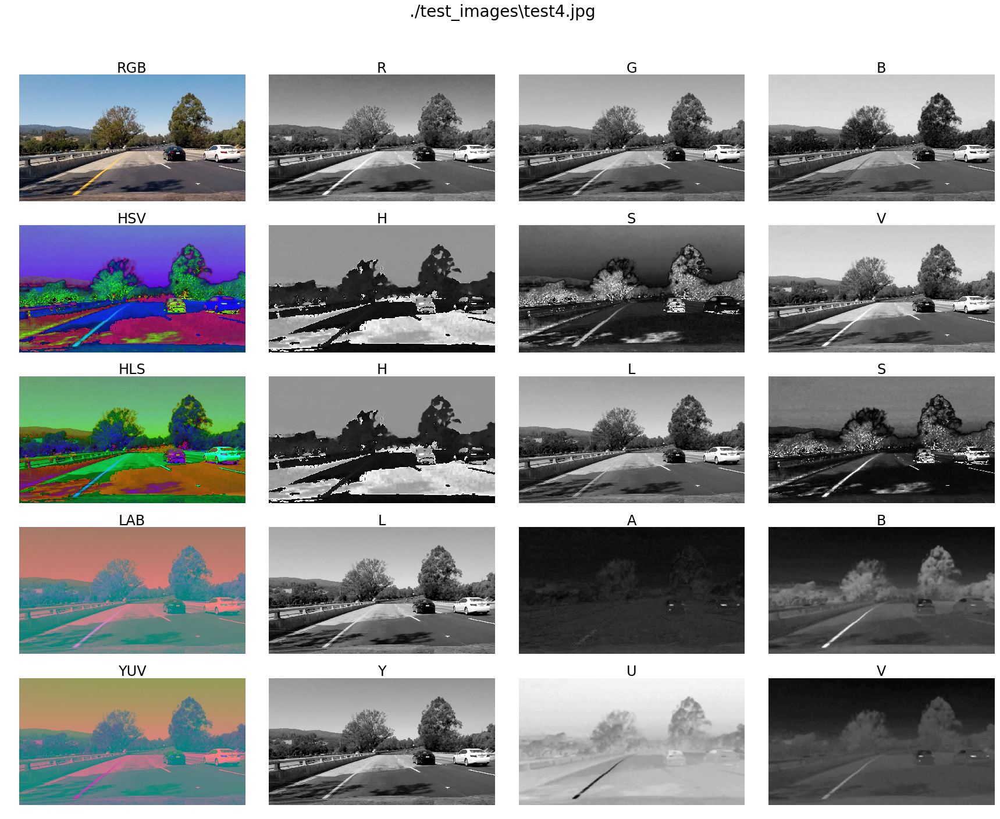

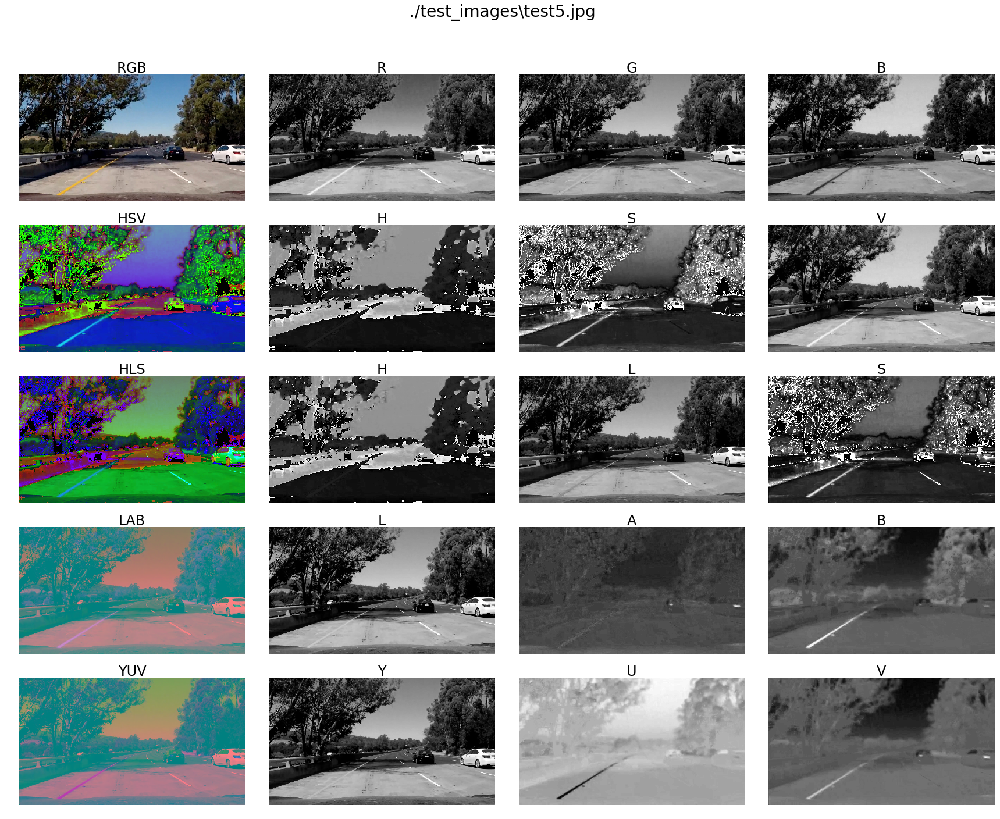

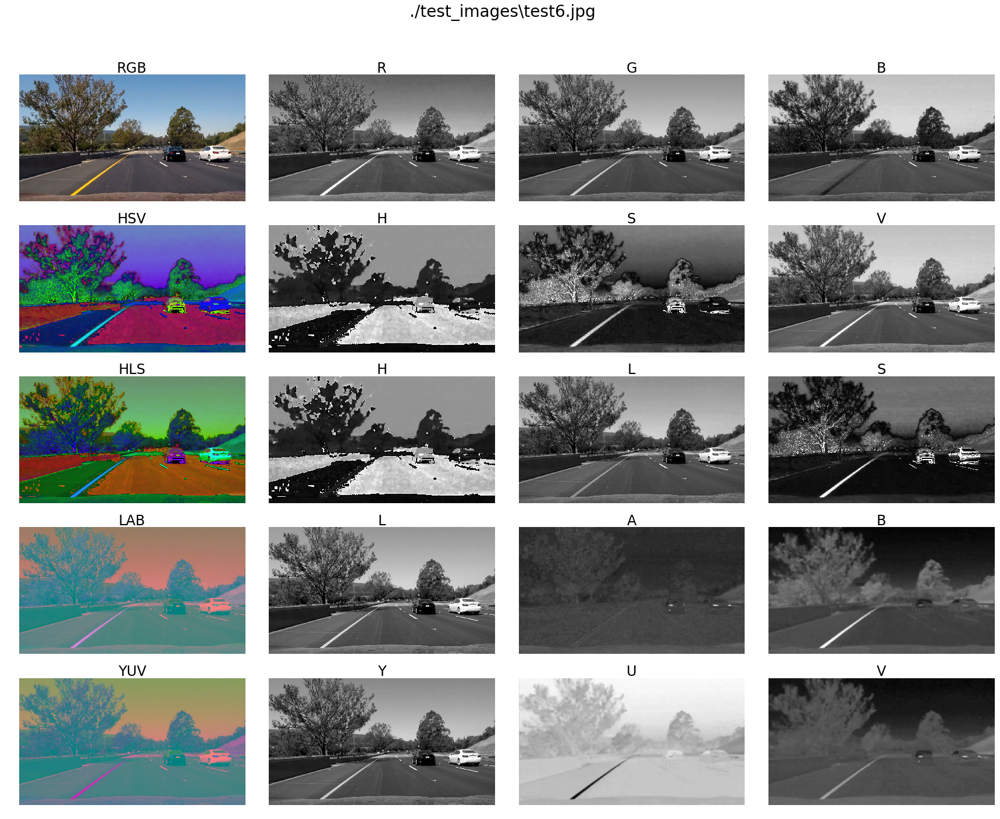

In [8]:
def viewImage(img_file):
    RGBimg = plt.imread(img_file)
    HSVimg = cv2.cvtColor(RGBimg, cv2.COLOR_RGB2HSV)
    HLSimg = cv2.cvtColor(RGBimg, cv2.COLOR_RGB2HLS)
    LABimg = cv2.cvtColor(RGBimg, cv2.COLOR_RGB2LAB)
    YUVimg = cv2.cvtColor(RGBimg,cv2.COLOR_RGB2YUV)
    
    fig, axes = plt.subplots(5, 4, figsize=(24, 20))
    fig.suptitle(img_file, fontsize=28)
    fig.tight_layout()
    plt.subplots_adjust(top=0.9)
    
    def plotAxis(idx0, idx1, img, title, cmap=None):
        axes[idx0, idx1].set_title(title, fontdict={'fontsize': 24, 'fontweight': 'medium'})
        axes[idx0, idx1].axis('off')
        axes[idx0, idx1].imshow(img, cmap=cmap)

    plotAxis(0,0,RGBimg,"RGB")
    plotAxis(0,1,RGBimg[:,:,0],"R", cmap="gray")
    plotAxis(0,2,RGBimg[:,:,1],"G", cmap="gray")
    plotAxis(0,3,RGBimg[:,:,2],"B", cmap="gray")

    plotAxis(1,0,HSVimg,"HSV")
    plotAxis(1,1,HSVimg[:,:,0],"H", cmap="gray")
    plotAxis(1,2,HSVimg[:,:,1],"S", cmap="gray")
    plotAxis(1,3,HSVimg[:,:,2],"V", cmap="gray")

    plotAxis(2,0,HLSimg,"HLS")
    plotAxis(2,1,HLSimg[:,:,0],"H", cmap="gray")
    plotAxis(2,2,HLSimg[:,:,1],"L", cmap="gray")
    plotAxis(2,3,HLSimg[:,:,2],"S", cmap="gray")

    plotAxis(3,0,LABimg,"LAB")
    plotAxis(3,1,LABimg[:,:,0],"L", cmap="gray")
    plotAxis(3,2,LABimg[:,:,1],"A", cmap="gray")
    plotAxis(3,3,LABimg[:,:,2],"B", cmap="gray")

    plotAxis(4,0,YUVimg,"YUV")
    plotAxis(4,1,YUVimg[:,:,0],"Y", cmap="gray")
    plotAxis(4,2,YUVimg[:,:,1],"U", cmap="gray")
    plotAxis(4,3,YUVimg[:,:,2],"V", cmap="gray")

    return RGBimg, HSVimg, HLSimg, LABimg, YUVimg

for img_file in im_files:
    RGBimg, HSVimg, HLSimg, LABimg, YUVimg = viewImage(img_file)

Special features of these images are:

* Test1: Dark patterns on the surface of the road.<br>
The S-channel of HLS is reflecting the lines quite well. The dark points are not visible there. The V-channel of HSV is relatively light and shows the dark patters as dark areas. The yellow line on the left side is quite well visible on the B-channel of the LAB.
* Test2: Right line is starting far away<br>
Relatively simple case with clear lane lines on dark background. S-channel of HLS, V-channel of HSV and B channel of LAB have clear and visible information.
* Test3: Relatively normal situation<br>
Same as Test2.
* Test4: Varying sunlight and darker shadows on the road.<br>
Dark shadows or patterns on the ground appear as light patterns in the S-channel of HLS, but they remain as dark parts in the V-channel of HSV. The B-channel of LAB shows the left yellow line quite clearly.
* Test5: Not so well visible lines and tree shadows<br>
To certain extent as before, but the edge of the shadow on the left side of the road is shown as light line in S-channel of HLS, while it remains dark in the V-channel of HSV.
* Test6: Less visible right line<br>
Follows same pattern as above mentioned.

My conclusion from above analysis is that combination of S-channel of HLS and V-channel of HSV will give a rich input for the analysis. I have noticed that sometimes, there are light patterns that are not visible in S-channel of HLS, but in the V-channel of HSV. The V-channel will be used at two levels. At very high level, it will find complementary light lines and a lower limit can be set for areas that are not interesting, such as shadows and patterns on the road.

The weakness of the V-channel and S-channels would be that light yellow will be less visible. On the other hand, the B-channel of the LAB is sensitive to yellow. I decided to choose that instead of making S-channel or V-channel more sensitive. The weakness of the latter would be that more noise will come into the picture.

I wanted to use YUV to bring the lighting to a 'standard' level and eliminate dependencies on time, but I did not succeed. Also, I tried to adjust for strong variation of the road intensity lighting, but could not find a reasonable method.

Next, I start to create binary images by thresholding the gray scale images.The following methods provide the necessary functionality.

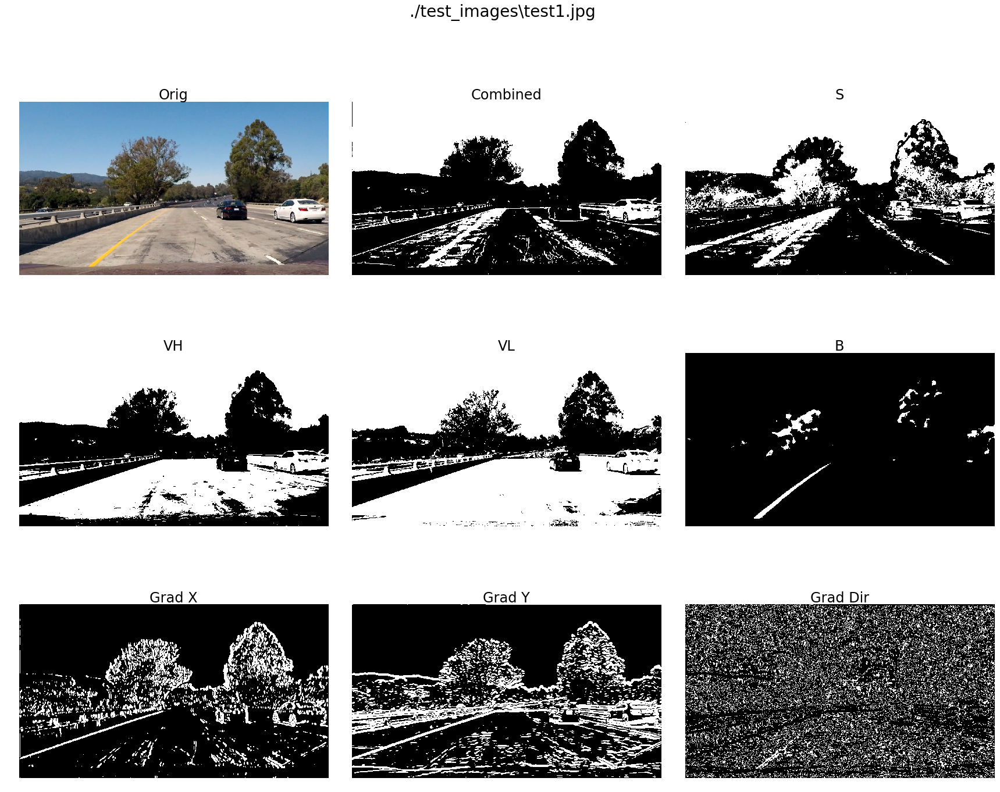

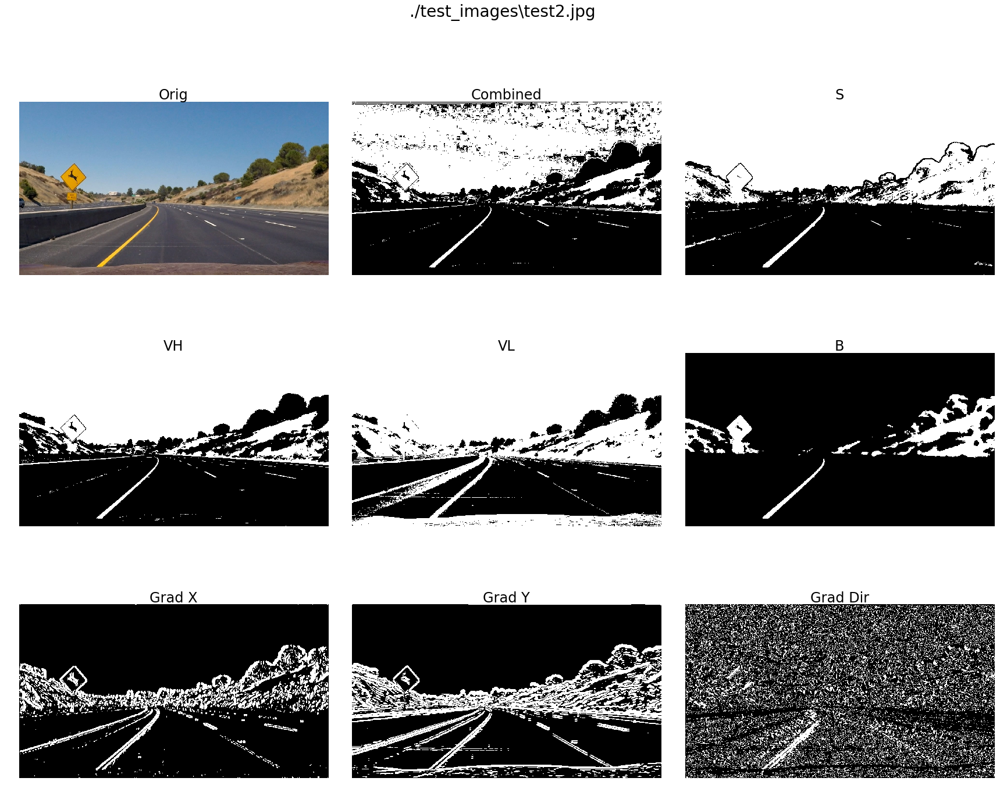

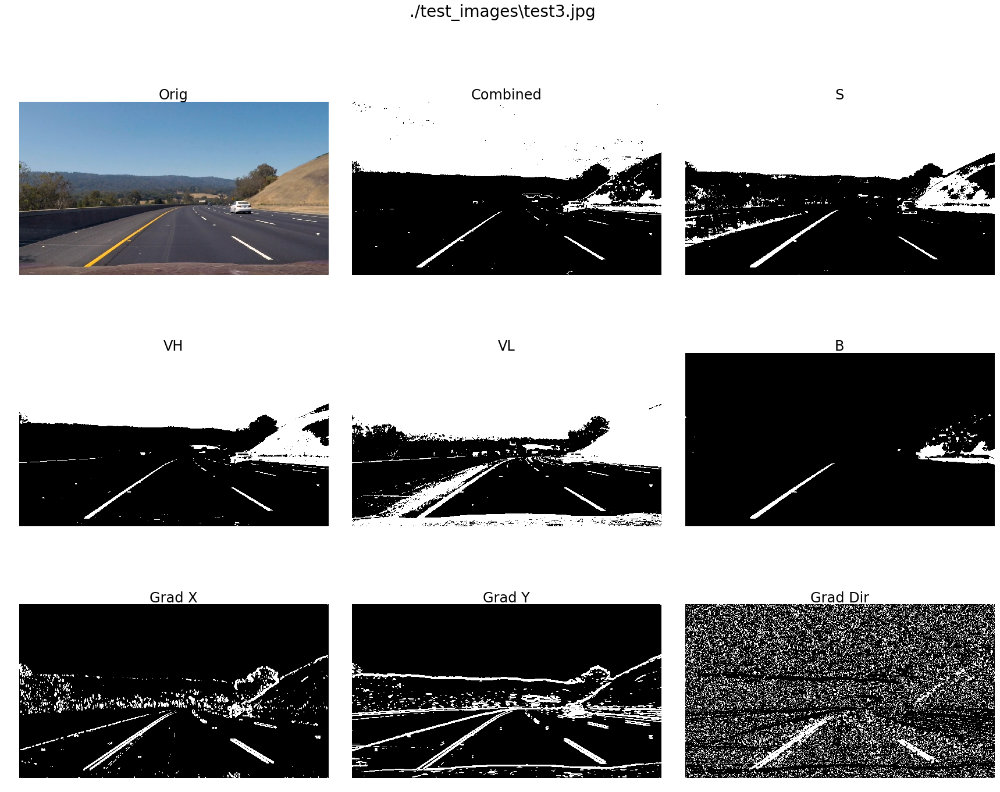

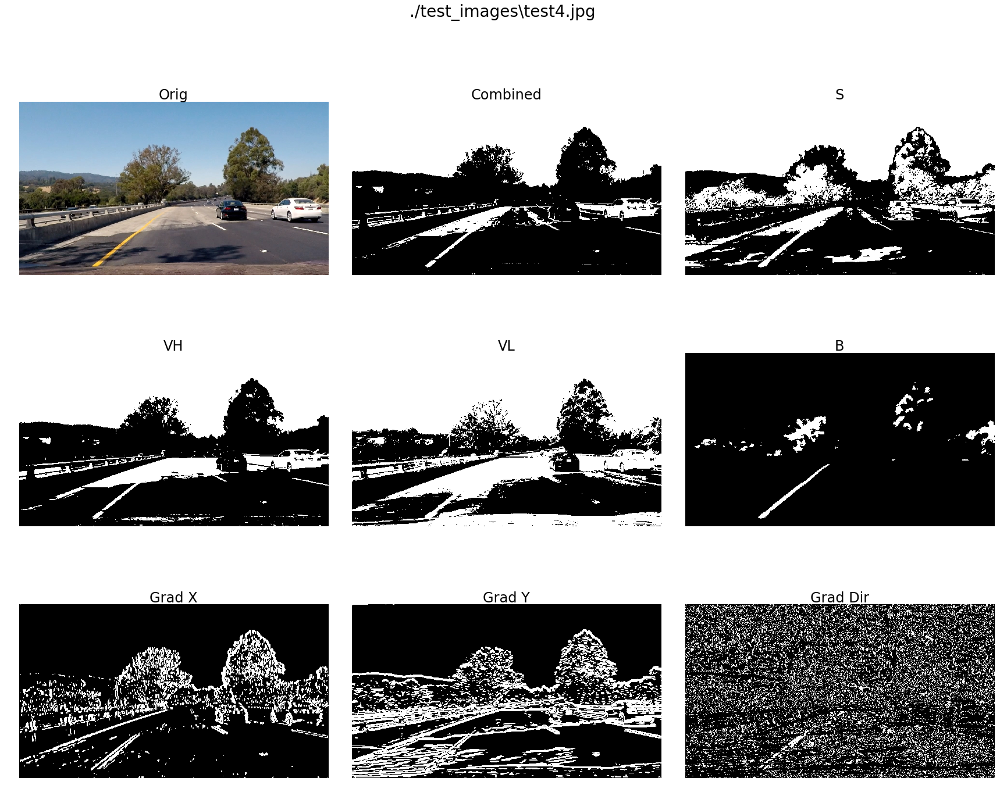

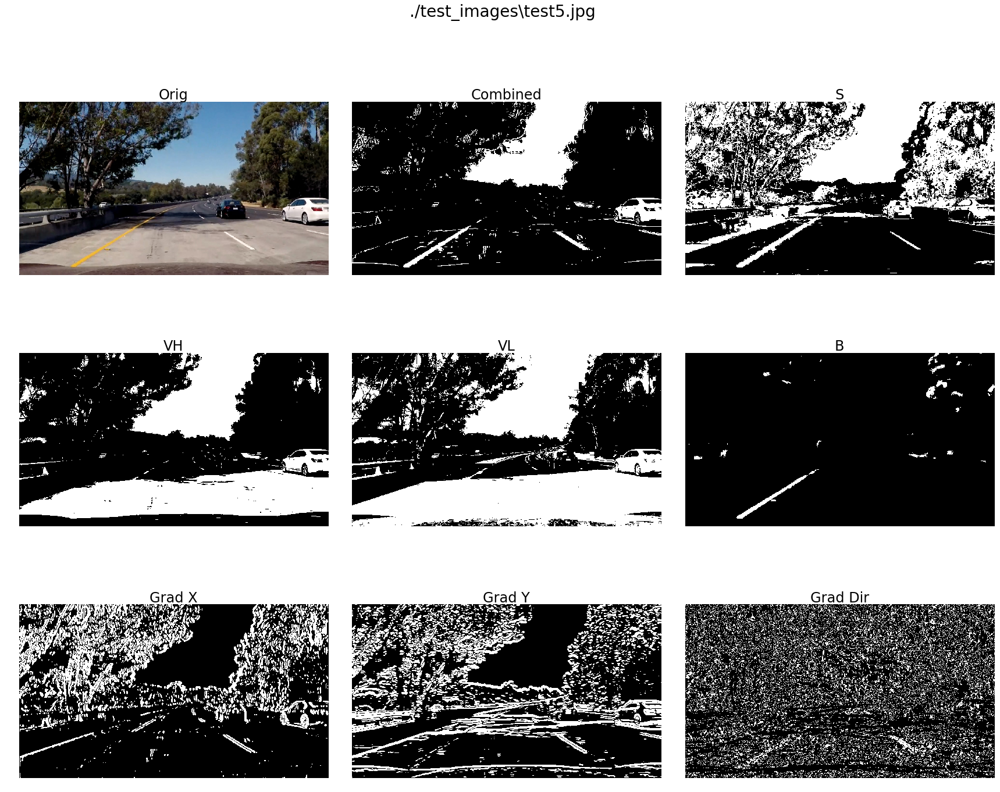

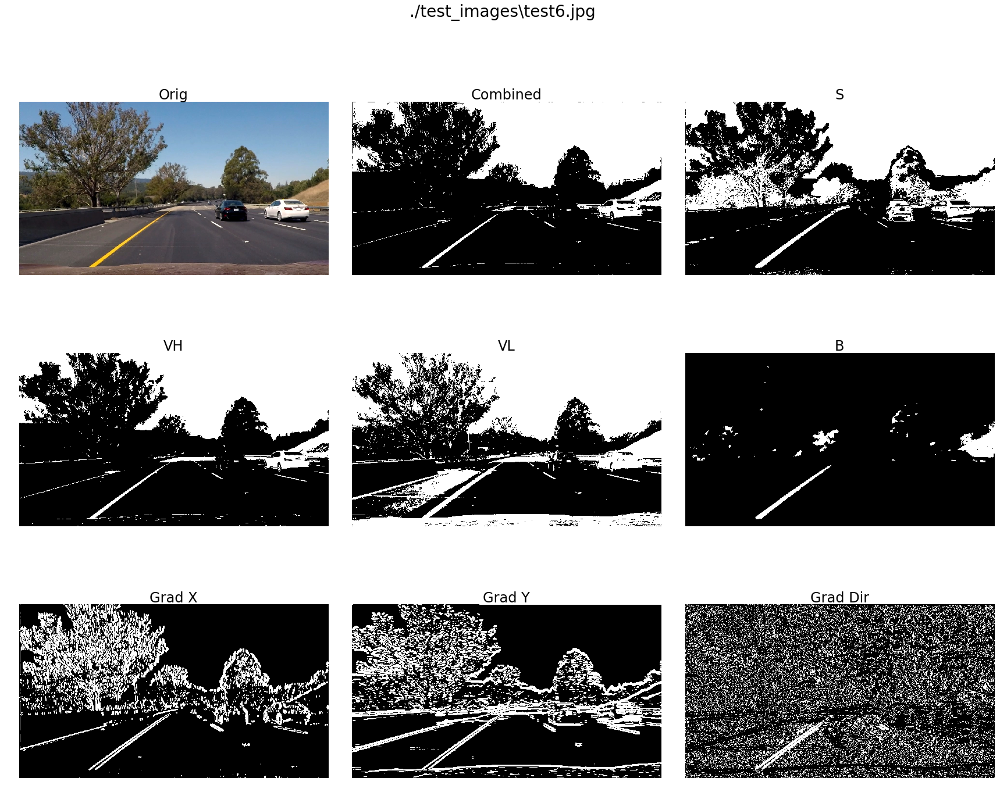

In [9]:
"""
    The folowing methods are a rewrite of those used in the course and quizes. 

"""
#   Thresholds any array. 
def thresholdArray(arr, thresh=(0, 255)):
    binary_output = np.zeros((arr.shape[0],arr.shape[1]), dtype=np.uint8)
    binary_output[(arr >= thresh[0]) & (arr <= thresh[1])] = 255
    return binary_output

#   Calculates sobel gradients in x and y directions and returns them 
#   separately together with the magniture and direction.
def sobel_gradients(img, kernel=9):
    sobel_x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=kernel)
    abs_sobel_x = np.absolute(sobel_x)
    scaled_sobel_x = np.uint8(255*abs_sobel_x/np.max(abs_sobel_x))
    sobel_y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=kernel)
    abs_sobel_y = np.absolute(sobel_y)
    scaled_sobel_y = np.uint8(255*abs_sobel_y/np.max(abs_sobel_y))
    abs_grad_dir = np.arctan2(np.absolute(sobel_y), np.absolute(sobel_x))
    abs_grad = np.sqrt(sobel_x**2 + sobel_y**2)
    abs_grad = abs_grad / np.max(abs_grad)
    return scaled_sobel_x, scaled_sobel_y, abs_grad, abs_grad_dir

#   Thresholds an RGB image using s-channel and l-channel of hls, and v-channel of
#   hsv. Following the proposal in the course, l-channel of hls is differentiated.
#   v-channel is used at two levels, one for discovering light areas, according to 
#   vh_th limits and one for eliminating dark areas, according to vl-th.
#   the output is combined_binary[((bin_s|bin_x|bin_y|bin_m|bin_d|bin_vh) & bin_vl)>0] = 255
#   note that the default thresholds will result in no-match.
def thresholdImage(RGBimg, vl_th=(255, -255), vh_th=(255, -255), s_th=(255, -255), b_th=(255, -255), sx_th=(255, -255), sy_th=(255,-255), gm_th=(1.0,-1.0), gd_th=(1.0, -1.0)):
    hls = cv2.cvtColor(RGBimg, cv2.COLOR_RGB2HLS)
    l_channel = cv2.blur(hls[:,:,1],(7,7))
    s_channel = hls[:,:,2]

    hsv = cv2.cvtColor(RGBimg, cv2.COLOR_RGB2HSV)
    v_channel = hsv[:,:,2]#cv2.equalizeHist(hsv[:,:,2])

    lab = cv2.cvtColor(RGBimg, cv2.COLOR_RGB2LAB)
    b_channel = lab[:,:,2]#cv2.equalizeHist(lab[:,:,2])

    sobel_x, sobel_y, grad_m, grad_d = sobel_gradients(l_channel, kernel=9)
    
    bin_x = thresholdArray(sobel_x, thresh=sx_th)
    bin_y = thresholdArray(sobel_y, thresh=sy_th)
    bin_m = thresholdArray(grad_m,  thresh=gm_th)
    bin_d = thresholdArray(grad_d,  thresh=gd_th)
    
    bin_s  = thresholdArray(s_channel,  thresh=s_th)
    bin_b  = thresholdArray(b_channel,  thresh=b_th)
    bin_vl = thresholdArray(v_channel,  thresh=vl_th)
    bin_vh = thresholdArray(v_channel,  thresh=vh_th)

    combined_binary = np.zeros_like(s_channel)
    combined_binary[((bin_s|bin_x|bin_y|bin_m|bin_d|bin_vh|bin_b) & bin_vl)>0] = 255 

    return combined_binary

#   This method is only for plotting the results
def viewThreshImage(img_file):
    RGBimg = plt.imread(img_file)

    fig, axes = plt.subplots(3, 3, figsize=(24, 20))
    fig.suptitle(img_file, fontsize=28)
    fig.tight_layout()
    plt.subplots_adjust(top=0.9)
    
    def plotAxis(idx0, idx1, img, title, cmap=None):
        axes[idx0, idx1].set_title(title, fontdict={'fontsize': 24, 'fontweight': 'medium'})
        axes[idx0, idx1].axis('off')
        axes[idx0, idx1].imshow(img, cmap=cmap)

    cmb_b_ALL = thresholdImage(RGBimg, vl_th=(150, 255), vh_th=(200, 255), b_th=(150, 255), s_th=(100, 255), sx_th=(20, 255), sy_th=(50,255))
    cmb_b_S = thresholdImage(RGBimg, s_th=(60, 255), vl_th=(0, 255))
  
    cmb_b_VH = thresholdImage(RGBimg, vh_th=(150, 255), vl_th=(0, 255))
    cmb_b_VL = thresholdImage(RGBimg, vl_th=(100, 255), s_th=(0, 255))
    cmb_b_GM = thresholdImage(RGBimg, b_th=(150, 255), vl_th=(0, 255))
    
    cmb_b_GX = thresholdImage(RGBimg, sx_th=(20, 255), vl_th=(0, 255))
    cmb_b_GY = thresholdImage(RGBimg, sy_th=(20,255), vl_th=(0, 255))
    cmb_b_GD = thresholdImage(RGBimg, gd_th=(0.7, 1.1), vl_th=(0, 255))


    plotAxis(0,0,RGBimg,"Orig")
    plotAxis(0,1,cmb_b_ALL,"Combined", cmap="gray")
    plotAxis(0,2,cmb_b_S,  "S", cmap="gray")
    plotAxis(1,0,cmb_b_VH,"VH", cmap="gray")
    plotAxis(1,1,cmb_b_VL,"VL", cmap="gray")
    plotAxis(1,2,cmb_b_GM,"B", cmap="gray")
    plotAxis(2,0,cmb_b_GX,"Grad X", cmap="gray")
    plotAxis(2,1,cmb_b_GY,"Grad Y", cmap="gray")
    plotAxis(2,2,cmb_b_GD,"Grad Dir", cmap="gray")

    return cmb_b_ALL

for img_file in im_files:
    cmb_b_ALL = viewThreshImage(img_file)

The above values were actually found after some trial and error and seem to give reasonably good results for the test images. I originally tried with the magnitude of the gradient and the direction, but could not find any reasonable threasholds.

Although the above results are acceptable, I met problems when it was applied to the videos. An example is image 116 in the challenge video, as shown below. 

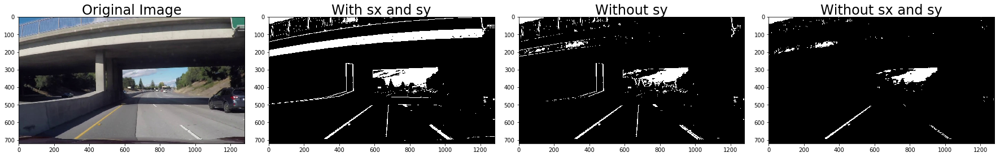

In [10]:
RGBimg = plt.imread("challenge_video_frames/frame116.jpg")
cmb_b_ALL_1 = thresholdImage(RGBimg, vl_th=(150, 255), vh_th=(200, 255), b_th=(150, 255), s_th=(100, 255), sx_th=(20, 255), sy_th=(50,255))
cmb_b_ALL_2 = thresholdImage(RGBimg, vl_th=(150, 255), vh_th=(220, 255), b_th=(150, 255), s_th=(100, 255), sx_th=(20, 255))
cmb_b_ALL_3 = thresholdImage(RGBimg, vl_th=(150, 255), vh_th=(220, 255), b_th=(150, 255), s_th=(100, 255))

fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
fig.tight_layout()
ax1.imshow(RGBimg)
ax1.set_title('Original Image', fontsize=24)
ax2.imshow(cmb_b_ALL_1, cmap="gray")
ax2.set_title('With sx and sy', fontsize=24)
ax3.imshow(cmb_b_ALL_2, cmap="gray")
ax3.set_title('Without sy', fontsize=24)
ax4.imshow(cmb_b_ALL_3, cmap="gray")
ax4.set_title('Without sx and sy', fontsize=24)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

As can be seen above, the y-derivative creates horizontal lines and the x derivative vertical ones that are not real ones, but actually edges between dark and light regions. The color-only based binary image, the one to the right, on the other hand gives a clear image.

## Perspective transform and creating bird-eye images
Undistortion can be done with the existing cameraCalData, but I will need the transformation matrix for warping the images.This matrix depends on the relative positon of camera relative the object. In the application we have, this relation is constant and therefore the matrix, $M$, can be computed one single time. 

To compute the matrix, I need coordinates of some specific points and the corresponding destination. For that, I intend to use test images with straight lanes. I can manually read the coordinates, but instead, I use the line finder with interpolation/extrapolation from the previous lab and find start points and end points of the found lanes as source and then map them on straigt lines with the same distance at the end as at the start.  

In [11]:
"""
    These methods are taken from previous lab with minor changes. Hough transform is used 
    to find lines, and then two straight lines are approximated. The starts and the ends 
    of the lines is used for calculation of sources and then they are stretched so that 
    the perspective view opens up.  
"""

def draw_two_lines(img, lines, color=[255, 0, 0], thickness=2):
    
    imshape = img.shape
    xmax = imshape[1]
    ymax = imshape[0]
    
    positiveSlope = 0
    negativeSlope = 0
    positiveCount = 0
    negativeCount = 0
    positiveMidX = 0
    positiveMidY = 0
    negativeMidX = 0
    negativeMidY = 0

    for line in lines:
        for x1,y1,x2,y2 in line:
            dx = x2 - x1
            dy = y2 - y1
            mx = (x2 + x1)/2
            my = (y2 + y1)/2
            if (abs(dy)>0):
                slope = dx/dy
                if (abs(slope) < (xmax/2-40)/(ymax/2-50)):
                    if (slope > 0):
                        positiveMidX = (positiveMidX*positiveCount + mx)/(positiveCount + 1)
                        positiveMidY = (positiveMidY*positiveCount + my)/(positiveCount + 1)
                        positiveSlope = (positiveSlope*positiveCount + slope)/(positiveCount + 1)
                        positiveCount = positiveCount + 1
                    else:
                        negativeMidX = (negativeMidX*negativeCount + mx)/(negativeCount + 1)
                        negativeMidY = (negativeMidY*negativeCount + my)/(negativeCount + 1)
                        negativeSlope = (negativeSlope*negativeCount + slope)/(negativeCount + 1)
                        negativeCount = negativeCount + 1
    dy = ymax - positiveMidY
    x1 = positiveMidX + dy * positiveSlope
    y1 = ymax
    x2 = x1 - (ymax/2 - 100) * positiveSlope
    y2 = ymax/2 + 100
    cv2.line(img, (int(x1), int(y1)), (int(x2), int(y2)), color, thickness)
    right_lane = [[int(x1), int(y1)], [int(x2), int(y2)]]

    dy = ymax - negativeMidY
    x1 = negativeMidX + dy * negativeSlope
    y1 = ymax
    x2 = x1 - (ymax/2 - 100) * negativeSlope
    y2 = ymax/2 + 100
    cv2.line(img, (int(x1), int(y1)), (int(x2), int(y2)), color, thickness)
    left_lane = [[int(x1), int(y1)], [int(x2), int(y2)]]
    return [left_lane, right_lane]

def hough_two_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    lines = cv2.HoughLinesP(img, rho, theta, threshold, np.array([]), minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    lanes = draw_two_lines(line_img, lines, thickness=10)
    return line_img, lanes

def lane_finder_2(image,kernel=3, \
                canny_l=100, canny_h=200, \
                rho=2, theta=0.02, threshold=20, min_len=20, max_gap=20):
    imshape = image.shape
    xmax = imshape[1]
    ymax = imshape[0]
#    maskVertices = np.array([[(80,ymax),(xmax/2-40,ymax/2+50), (xmax/2+40,ymax/2+50), (xmax-60,ymax)]],dtype=np.int32)
    maskVertices = np.array([[(80,ymax),(xmax/2-40,ymax/2+50), (xmax/2+40,ymax/2+50), (xmax-60,ymax)]],dtype=np.int32)

    grayImage = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    grayBlurImage = cv2.GaussianBlur(grayImage, (kernel, kernel), 0)
    edges = cv2.Canny(grayBlurImage,canny_l, canny_h)
    interestingRegion = mask_region_of_interest(edges,maskVertices)
    lineImage, lanes = hough_two_lines(interestingRegion, rho, theta, threshold, min_len, max_gap)

    return lineImage, lanes

def getSourceDestination(image):
    lineImage, lanes = lane_finder_2(image,kernel=5, canny_l=80, canny_h=160, \
        rho=1, theta=0.005, min_len=100, threshold=20, max_gap=100)
    
    sourcePoints =      np.float32([lanes[0][0],lanes[0][1],lanes[1][1],lanes[1][0]])
    x0 = sourcePoints[3,0] - sourcePoints [0,0]
    x1 = sourcePoints[2,0] - sourcePoints [1,0]
    factor = x1/x0;
    print("Source points for M: ")
    print(sourcePoints)
    sourcePoints[1,0] = sourcePoints[1,0] - np.int(sourcePoints[0,0]*factor)
    sourcePoints[2,0] = sourcePoints[2,0] + np.int((1280 - sourcePoints[3,0])*factor)
    sourcePoints[0,0] = 0
    sourcePoints[3,0] = 1280
    destinationPoints = np.copy(sourcePoints)
    destinationPoints[0,0] =    0 + 1280/4
    destinationPoints[3,0] = 1280 - 1280/4
    destinationPoints[1,0] = destinationPoints[0,0]
    destinationPoints[1,1] = 100
    destinationPoints[2,0] = destinationPoints[3,0]
    destinationPoints[2,1] = 100
    print("Destination points for M: ")
    print(sourcePoints)

    

    return lineImage, sourcePoints, destinationPoints

My transform is such that the lower corners of the source image are mapped to the lower corners of the destination and then, corresponding points for the upper corners are computed on the source image by assuming a similar scaling with the distance. 

Now, I have all elements to compute the starts and ends of the lane lines, get the sources and destinations and finally compute the transformation matrix.

Source points for M: 
[[  217.   720.]
 [  579.   460.]
 [  704.   460.]
 [ 1104.   720.]]
Destination points for M: 
[[    0.   720.]
 [  549.   460.]
 [  728.   460.]
 [ 1280.   720.]]


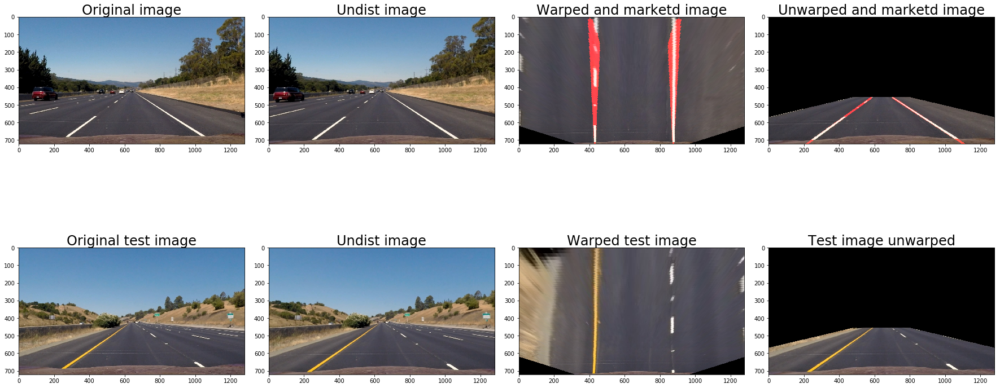

In [12]:
img1 = plt.imread('test_images/straight_lines2.jpg')

undist1 = undistortImage(img1, cameraCalData)

markedImage, srcPts, dstPts = getSourceDestination(undist1)
M = cv2.getPerspectiveTransform(srcPts, dstPts)
Minv = cv2.getPerspectiveTransform(dstPts, srcPts)

warpedImage1 = warper(weighted_img(undist1,markedImage),M)
unwarpedImage1 = warper(warpedImage1,Minv)

img2 = plt.imread('test_images/straight_lines1.jpg')

undist2 = undistortImage(img2, cameraCalData)

warpedImage2 = warper(undist2,M)
unwarpedImage2 = warper(warpedImage2,Minv)


fig, axes = plt.subplots(2, 4, figsize=(24, 9))
fig.tight_layout()
axes[0,0].imshow(img1)
axes[0,0].set_title('Original image', fontsize=24)
axes[0,1].imshow(undist1)
axes[0,1].set_title('Undist image', fontsize=24)
axes[0,2].imshow(warpedImage1)
axes[0,2].set_title('Warped and marketd image', fontsize=24)
axes[0,3].imshow(unwarpedImage1)
axes[0,3].set_title('Unwarped and marketd image', fontsize=24)

axes[1,0].imshow(img2)
axes[1,0].set_title('Original test image', fontsize=24)
axes[1,1].imshow(undist2)
axes[1,1].set_title('Undist image', fontsize=24)
axes[1,2].imshow(warpedImage2)
axes[1,2].set_title('Warped test image', fontsize=24)
axes[1,3].imshow(unwarpedImage2)
axes[1,3].set_title('Test image unwarped', fontsize=24)
plt.subplots_adjust(left=0., right=1, top=1.2, bottom=0.)

With the above methods, we can now transform an image to a binary one and transform it from perspective to the bird-eye form. 

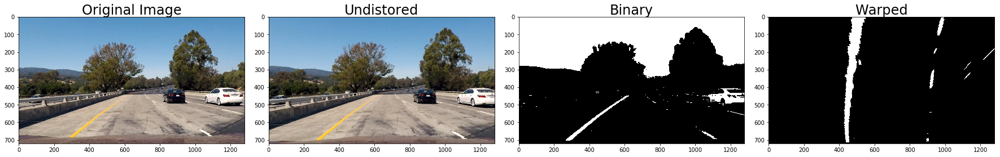

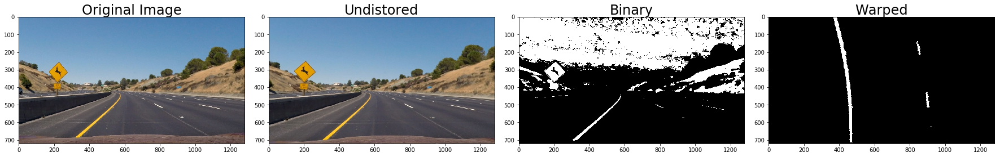

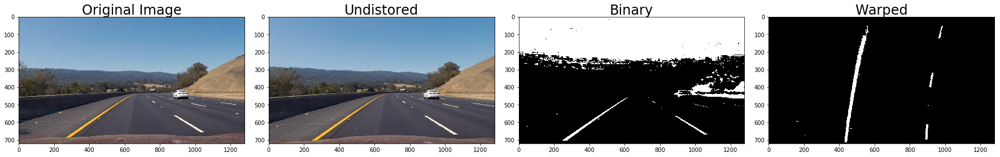

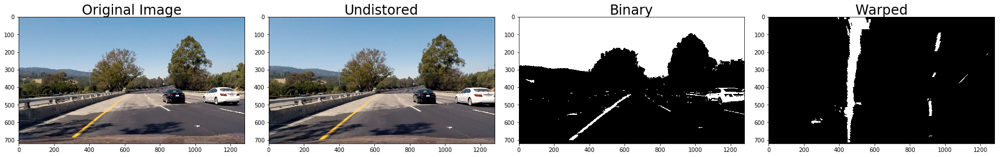

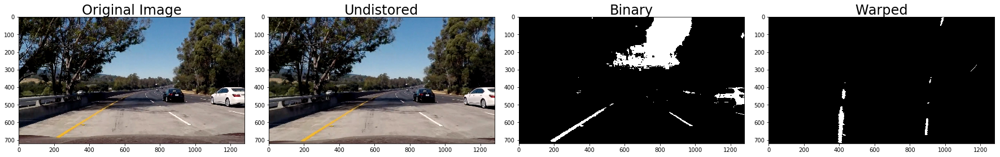

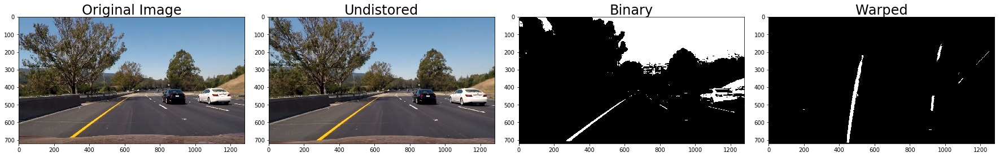

In [13]:

for img_file in im_files:
    RGBimg = plt.imread(img_file)
    undist = undistortImage(RGBimg, cameraCalData)
    cmb_b = thresholdImage(undist, vl_th=(150, 255), vh_th=(220, 255), b_th=(150, 255), s_th=(100, 255))
    
    
    warped_binary = warper(cmb_b,M)

    fig, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    fig.tight_layout()
    ax1.imshow(RGBimg)
    ax1.set_title('Original Image', fontsize=24)
    ax2.imshow(undist)
    ax2.set_title('Undistored', fontsize=24)
    ax3.imshow(cmb_b, cmap="gray")
    ax3.set_title('Binary', fontsize=24)
    ax4.imshow(warped_binary, cmap="gray")
    ax4.set_title('Warped', fontsize=24)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


## Finding lane lines and fitting 2nd order polynomial
To find the lane lines, I use a method close to the one presented in the course with the following differences:
1. I first divide the image into a number of sections in the vertical direction.
2. Go through the vertical sections and for each section I calculate a histogram.
3. Before searching the maximum point, I smooth the histogram out with a moving average.
4. I find the maximum point but with an offset from the midpoint of the lane
5. After that, I set the center of the window to the point with maximum number of hits.
Otherwise the same procedure is applied. The method find_lane_pixels_by_boxing does this work.

To have a good starting point, I use the mid-lane line from the previous step.

In [14]:
def find_lane_pixels_by_boxing(binary_warped, midLaneLine):
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    
    # Divide the vertical extent to 9 windows 
    nwindows = 9
    margin = 50
    minpix = 5

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    newMidPoint = False
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height

        # For the first window, use the previous midline
#        if (window == 0):
        midpoint = np.int(np.mean(midLaneLine[win_y_low:win_y_high]))
        leftx_current = midpoint - 450//2
        rightx_current = midpoint + 450//2
        # We look for pixels at a minimum distance from the middle of the lane
        offset = 75
        laneWidth = 450
        # Make a smoothed histogram by convolution of the sum with an array of ones
        histogram = np.convolve(np.sum(binary_warped[win_y_low:win_y_high,:], axis=0), np.ones((100,)), mode='same')
        # Calculate the midpoint and search for maximum in an area away from the midpoint
#        midpoint = (leftx_current + rightx_current)//2
        startpoint = min(midpoint - laneWidth, 0)
        endpoint = max(midpoint + laneWidth, binary_warped.shape[0] - 1)
        if (np.sum(histogram[startpoint:midpoint-offset]) > 0):
            leftx_base = np.argmax(histogram[startpoint:midpoint-offset]) + startpoint
            if (abs(leftx_base - leftx_current) < laneWidth//4):
                leftx_current = leftx_base
        if (np.sum(histogram[midpoint+offset:endpoint]) > 0):
            rightx_base = np.argmax(histogram[midpoint+offset:endpoint]) + midpoint + offset
            if (abs(rightx_base - rightx_current) < laneWidth//4):
                rightx_current = rightx_base

        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin

        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),
        (win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),
        (win_xright_high,win_y_high),(255,0,0), 2) 
        
        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    return leftx, lefty, rightx, righty, out_img

# This method fits polynomials to the left and right lane lines
def fit_poly(img_shape, leftx, lefty, rightx, righty):
     ### TO-DO: Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])

    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty
    
    return left_fitx, right_fitx, ploty, left_fit, right_fit

The following two methods are used for visualization of the lane and lane lines.

In [15]:
# This method visualizes the polynomials with a thick line
def view_polynomial(binary_warped, left_fitx, right_fitx, margin, a=1, b=0.5):

    window_img = np.zeros_like(binary_warped)
    ploty = np.linspace(0, window_img.shape[0]-1, window_img.shape[0])
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(binary_warped.shape) > 2:
        channel_count = binary_warped.shape[2]  # i.e. 3 or 4 depending on your image
        mask_color = (255,) * channel_count
    else:
        mask_color = 255
        
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), mask_color) # (255,255, 255))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), mask_color) # (255,255, 255))
    result = cv2.addWeighted(binary_warped, a, window_img, b, 0)
    
    return result 

# This method colors the surface of the lane 
def view_lanes(binary_warped, left_fitx, right_fitx, a=1, b=0.3):

    window_img = np.zeros_like(binary_warped)
    ploty = np.linspace(0, window_img.shape[0]-1, window_img.shape[0])
    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    lane_window_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    lane_window_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, 
                              ploty])))])
    lane_window_pts = np.hstack((lane_window_left, lane_window_right))

    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(binary_warped.shape) > 2:
        channel_count = binary_warped.shape[2]  # i.e. 3 or 4 depending on your image
        mask_color = (255,) * channel_count
    else:
        mask_color = 255
        
    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([lane_window_pts]), mask_color) # (255,255, 255))
    result = cv2.addWeighted(binary_warped, a, window_img, b, 0)
    return result 


Below, I test the methods with the test images.

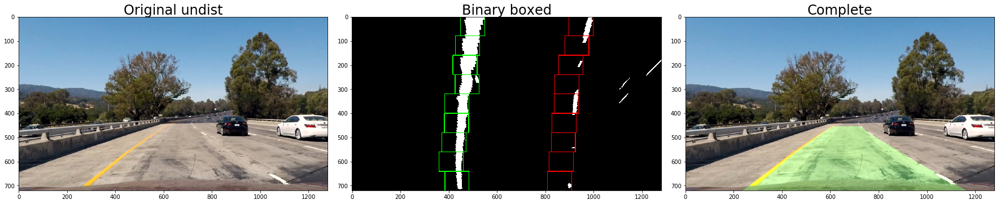

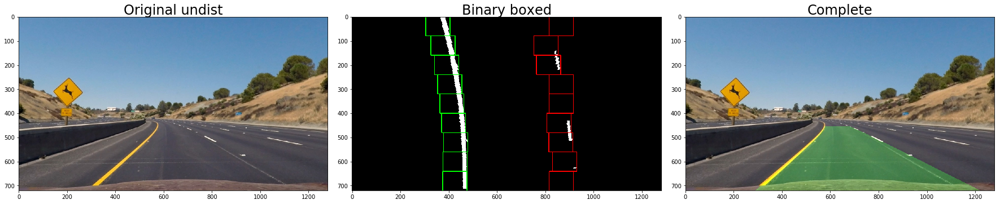

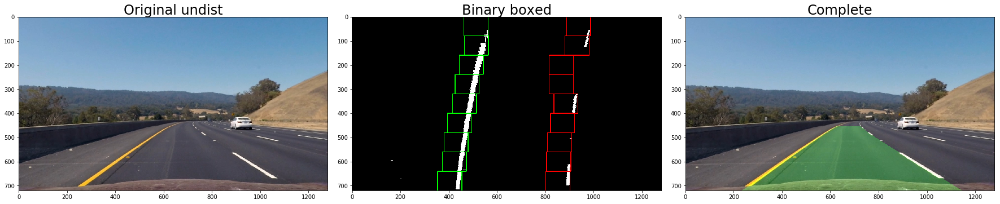

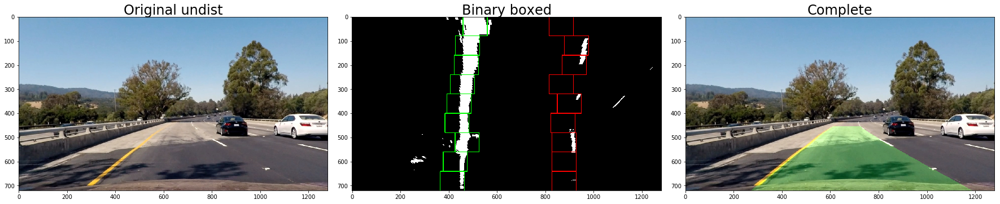

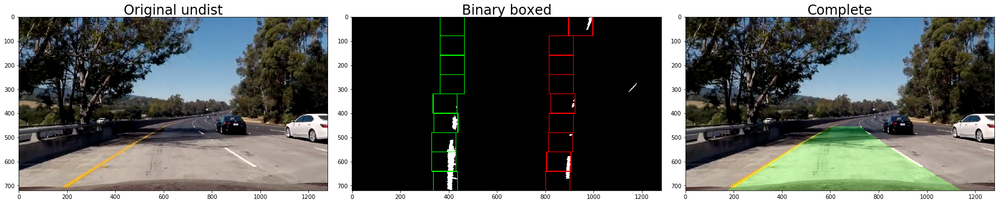

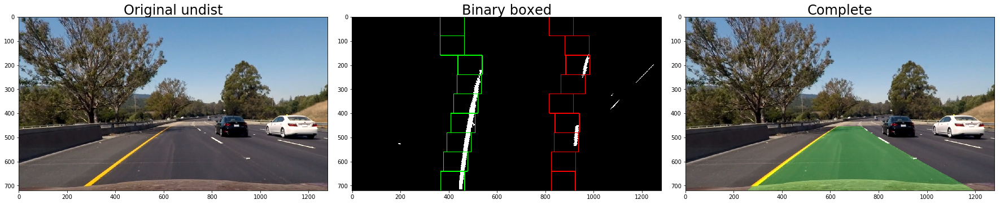

In [16]:
for img_file in im_files:
    RGBimg = plt.imread(img_file)
    undist = undistortImage(RGBimg, cameraCalData)
    binaryCmb = thresholdImage(undist, vl_th=(150, 255), vh_th=(220, 255), b_th=(150, 255), s_th=(100, 255))
    
    warpedBinary = warper(binaryCmb,M)
    midLaneLine = np.zeros(720,)+ 1280/2
    
    leftx, lefty, rightx, righty, boxedImage = find_lane_pixels_by_boxing(warpedBinary, midLaneLine)
    left_x_fitted, right_x_fitted, ploty, left_fit, right_fit = fit_poly(warpedBinary.shape, leftx, lefty, rightx, righty)
    polyImage = view_lanes(np.zeros_like(binaryCmb), left_x_fitted, right_x_fitted)
    unwarpedPolyImage = warper(polyImage, Minv)
    
    output = weighted_img(np.dstack((np.zeros_like(unwarpedPolyImage), unwarpedPolyImage, np.zeros_like(unwarpedPolyImage))),undist, a=1.0, b=0.8)

    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(24, 9))
    fig.tight_layout()
    ax1.imshow(undist)
    ax1.set_title('Original undist', fontsize=24)
    ax2.imshow(boxedImage)
    ax2.set_title('Binary boxed', fontsize=24)
    ax3.imshow(output)
    ax3.set_title('Complete', fontsize=24)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


As can be found in the above images, the method functions well when the lane lines are detected. When they are not, it will try to make an approximation that could be incorrect. Such cases are going to be handled by averaging or relaxation of the results.

## Lane lines, curvature and vehicle position
I decided to implement all main functions as methods in the Line class. The implementation is quite straight forward and follows the suggestions in the course. I have completed the __init__ method and added three more methods for easier data storage and calculattions.

A note-worthy point is the scaling factors that I have taken from suggestions I could find on internet.

In [17]:
class Line():
    def __init__(self, side, ym_per_pix = 30/720, xm_per_pix = 3.7/450):
        # save the scaling for later use
        self.xm_per_pix = xm_per_pix
        self.ym_per_pix = ym_per_pix
        # was the line detected in the last iteration?
        self.detected = False  
        # Number of fits of the line to keep
        self.n = 7
        # y-values
        self.y = np.linspace(0, 719, 720)
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the mid-line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        # x and y are initialized so that the lane will be assumed to be straight
        # if no lanes are discovered
        #x values for detected line pixels
        self.allx = np.zeros(720,)+ 1280/2
        #y values for detected line pixels
        self.ally = np.linspace(0, 719, 720)  
        if (side == "left"):
            self.allx = self.allx - 900/2
            self.line_base_pos = 640  - 900/2
        else:
            self.allx = self.allx + 900/2
            self.line_base_pos = 640  - 900/2
        self.bestx = self.allx
        self.recent_xfitted = [self.allx]
        self.noData = True
        for i in range(self.n-1):
            self.addNew_xfitted(self.allx)
        self.noData = True
        self.calcBestData()
        
    # A new fitted array is added. If it is the first time, it will fill the list.
    def addNew_xfitted(self, xfitted):
        if (self.noData):
            self.recent_xfitted = [xfitted]
            for i in range(self.n-1):
                self.recent_xfitted = [xfitted] + self.recent_xfitted
            self.noData = False
        else:
            self.recent_xfitted = [xfitted] + self.recent_xfitted[0:self.n-1]

    # This method calculates the best x values and then uses it to calcculate the 
    # polynomial, the curvature and the position of the line in the image.
    # Note that the mapping at the maximum y values are one-to-one.
    def calcBestData(self):
        lngth = len(self.recent_xfitted)
        self.bestx = sum(self.recent_xfitted)/lngth
        self.best_fit = np.polyfit(self.y, self.bestx, 2)
        fit_cr = np.polyfit(self.y*self.ym_per_pix, self.bestx*self.xm_per_pix, 2)
        y_eval = 719
        # Calculation of R_curve (radius of curvature)
        self.radius_of_curvature = ((1 + (2*fit_cr[0]*y_eval*self.ym_per_pix + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0]+0.001)
        y1 = y_eval*self.ym_per_pix
        y2 = y1*y1
        self.line_base_pos = (fit_cr[0]*y2 + fit_cr[1]*y1 + fit_cr[2]) - self.xm_per_pix * 640
        return self.bestx
    
    # This method saves the new found data in the structure and at the same time calculated
    # the polynomial coefficients.
    def setDetectedLines(self, x, y):
        self.allx = x
        self.ally = y
        newCoeff = np.polyfit(y, x, 2)
        self.diffs = self.current_fit - newCoeff
        self.current_fit = newCoeff


## The pipeline
The below method, process_image, assembles the above steps into a pipeline that processes every image in the video. The steps are as above and necessary quantitative data are calculated using the methods in Line class.

If the number of detected points is very low, the same data from previous step is used. If the changes are very large, a strong relaxation is used. Otherwise, the output is calculated by averaging over a numebr of recent fitted data (here set to 7). Please see the comments below for details.

In [18]:
def process_image(image):
    """
        Remove distortion, create binary image by thresholding and warp the image
    """
    global cameraCalData, leftLane, rightLane
    # undistord -> threshold -> warp 
    undist = undistortImage(image, cameraCalData)
    binaryCmb = thresholdImage(undist, vl_th=(150, 255), vh_th=(220, 255), b_th=(150, 255), s_th=(100, 255))
    warpedBinary = warper(binaryCmb, M)
    
    # Give and estimate of the midline from previous iteration and search for lane lines
    midLaneLine = np.int32((leftLane.bestx + rightLane.bestx)/2)
    leftx, lefty, rightx, righty, boxedImage = find_lane_pixels_by_boxing(warpedBinary, midLaneLine)
    
    # 
    if ((len(leftx) < 5) and (len(rightx) < 5)):
        leftx = leftLane.allx
        lefty = leftLane.ally
        rightx = rightLane.allx
        righty = rightLane.ally
        print("... Image skipped ...")
    else:
        if (len(leftx) < 5):
            leftx = leftLane.allx
            lefty = leftLane.ally
            print("... left replaced ...")
        if(len(rightx) < 5):
            rightx = rightLane.allx
            righty = rightLane.ally
            print("... right replaced ...")

    # Fit polynomial
    left_x_fitted, right_x_fitted, ploty, left_fit, right_fit = fit_poly(warpedBinary.shape, leftx, lefty, rightx, righty)
    
    # If the changes are large, relax the changes.
    relaxation = 0.15
    if (np.max((left_x_fitted-leftLane.bestx)**2)> 200000):
        left_x_fitted = np.int32(relaxation*left_x_fitted+(1-relaxation)*leftLane.bestx)
        
    if (np.max((right_x_fitted-rightLane.bestx)**2)> 200000):
        right_x_fitted = np.int32(relaxation*right_x_fitted+(1-relaxation)*rightLane.bestx)

    # Add the data to the Line objects and calculate the data
    leftLane.addNew_xfitted(left_x_fitted)
    leftLane.setDetectedLines(leftx, lefty)
    leftLane.calcBestData()
    
    rightLane.addNew_xfitted(right_x_fitted)
    rightLane.setDetectedLines(rightx, righty)
    rightLane.calcBestData()


    """ 
        Prepare image to output 
    """
    
    height, width = binaryCmb.shape

    imgScale = 1/6
    startX = 100
    newX,newY = warpedBinary.shape[1]*imgScale, warpedBinary.shape[0]*imgScale
    
    # Add warped undist image
    newimg = cv2.resize(warper(undist,M),(int(newX),int(newY)))    
    height, width = newimg.shape[0], newimg.shape[1]
    offsetX = startX + (10 + width)*0
    offsetY = 10
    
    undist[offsetY:offsetY+height,offsetX:offsetX+width] = newimg

    # Add the boxes for line finding
    newimg = cv2.resize(boxedImage,(int(newX),int(newY)))    
    offsetX = startX + (10 + width)*1
    offsetY = 10
    
    undist[offsetY:offsetY+height,offsetX:offsetX+width] = newimg#np.dstack([newimg,newimg,newimg])

    # Add the polynoms as thick lines
    polyImage = view_polynomial(np.zeros_like(binaryCmb), leftLane.bestx, rightLane.bestx, 50)
    newimg = cv2.resize(polyImage,(int(newX),int(newY)))    
    offsetX = startX + (10 + width)*2
    offsetY = 10
    
    undist[offsetY:offsetY+height,offsetX:offsetX+width] = np.dstack([newimg,newimg,newimg])

    # Add the warped discovered lane
    polyImage = view_lanes(np.zeros_like(binaryCmb), leftLane.bestx, rightLane.bestx)
    polyImage = weighted_img(np.dstack((np.zeros_like(polyImage), polyImage, np.zeros_like(polyImage))),np.dstack((warpedBinary, warpedBinary, warpedBinary)), a=1.0, b=0.8)
    newimg = cv2.resize(polyImage,(int(newX),int(newY)))    
    offsetX = startX + (10 + width)*3
    offsetY = 10
    
    undist[offsetY:offsetY+height,offsetX:offsetX+width] = newimg#np.dstack([newimg,newimg,newimg])
    
    # Calculate offset from the mid line, calculate curvatures and report
    lane_offset = (leftLane.line_base_pos + rightLane.line_base_pos)/2
    
    lane_offset_text = ""
    if (lane_offset < 0):
        lane_offset_text = "to right"
        lane_offset = -lane_offset
    else:
        lane_offset_text = "to left"
    
    left_curfature_text  = "Left  curv. : {0:18}".format("{:.1f} m".format(leftLane.radius_of_curvature))
    right_curfature_text = "Right curv. : {0:18}".format("{:.1f} m".format(rightLane.radius_of_curvature))
    center_offset_text   = "Lane center.: {0:18}".format("{:.1f} m ".format(lane_offset) + lane_offset_text)
    lane_width_text      = "Lane width  : {0:18}".format("{:.1f} m ".format(-leftLane.line_base_pos + rightLane.line_base_pos))
    
    text_img=np.zeros_like(image)
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(text_img,  left_curfature_text, (100, 150), font, 2.5, (255,255,255), 5, cv2.LINE_AA)
    cv2.putText(text_img, right_curfature_text, (100, 300), font, 2.5, (255,255,255), 5, cv2.LINE_AA)
    cv2.putText(text_img, center_offset_text  , (100, 450), font, 2.5, (255,255,255), 5, cv2.LINE_AA)
    cv2.putText(text_img, lane_width_text     , (100, 600), font, 2.5, (255,255,255), 5, cv2.LINE_AA)

    newimg = cv2.resize(text_img,(int(newX),int(newY)))    
    height, width = newimg.shape[0], newimg.shape[1]
    offsetX = startX + (10 + width)*4
    offsetY = 10
    
    undist[offsetY:offsetY+height,offsetX:offsetX+width] = newimg
    
    polyImage = view_lanes(np.zeros_like(binaryCmb), leftLane.bestx, rightLane.bestx)
    unwarpedPolyImage = warper(polyImage, Minv)
    
    result = weighted_img(np.dstack((np.zeros_like(unwarpedPolyImage), unwarpedPolyImage, np.zeros_like(unwarpedPolyImage))),undist, a=1.0, b=0.8)

    return result

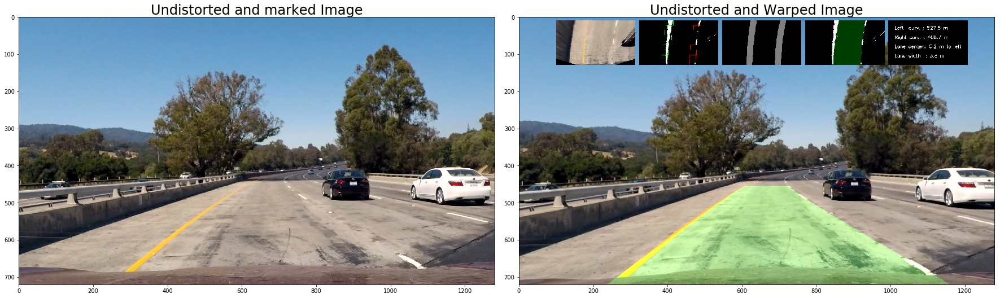

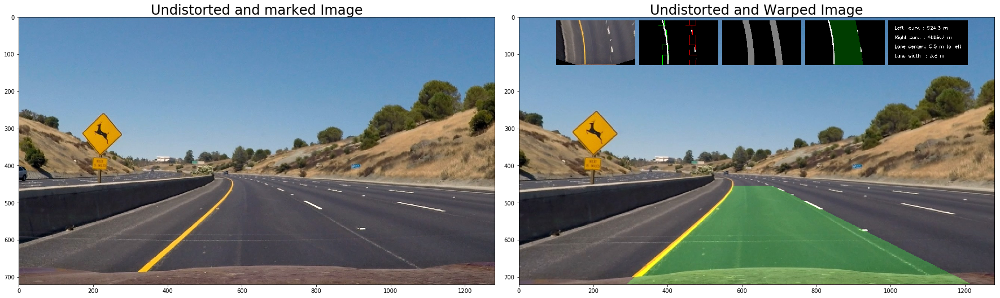

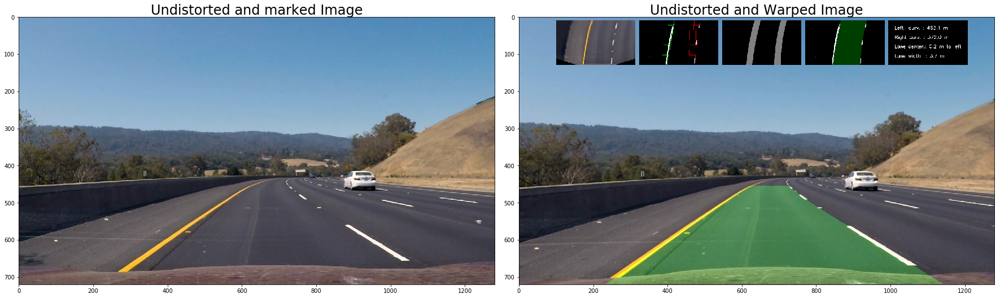

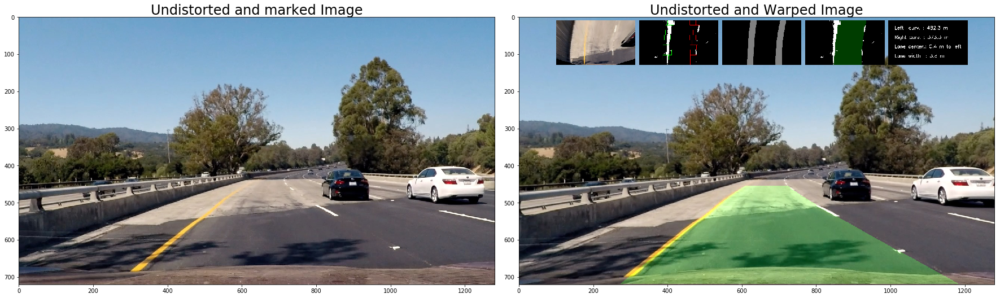

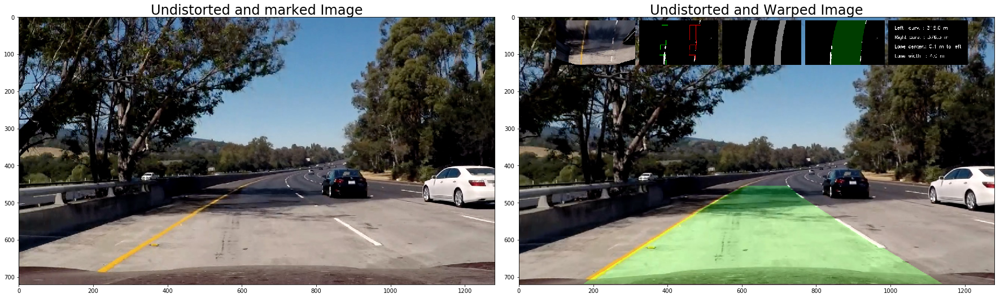

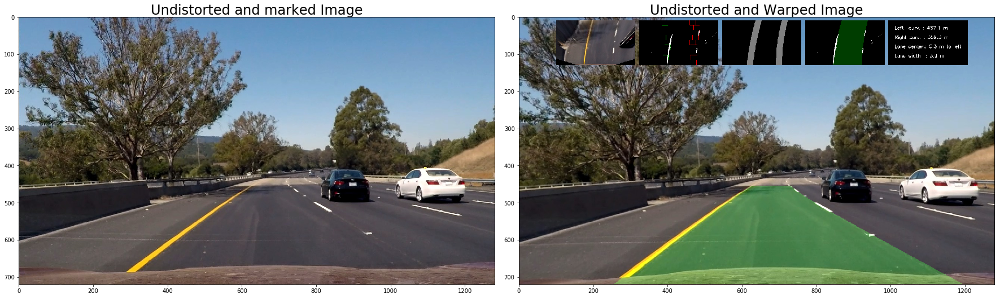

In [19]:
for im_file in im_files:
    leftLane = Line("left")
    rightLane = Line("right")
    img = plt.imread(im_file)
    processed_img = process_image(img)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Undistorted and marked Image', fontsize=24)
    ax2.imshow(processed_img)
    ax2.set_title('Undistorted and Warped Image', fontsize=24)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


In [21]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [22]:
leftLane = Line("left")
rightLane = Line("right")
input_filename = 'project_video'
result_output = input_filename + '_output.mp4'
clip1 = VideoFileClip(input_filename + ".mp4")#.subclip(0,10)
result_clip = clip1.fl_image(process_image) 
%time result_clip.write_videofile(result_output, audio=False)

Moviepy - Building video project_video_output.mp4.
Moviepy - Writing video project_video_output.mp4



Moviepy - Done !
Moviepy - video ready project_video_output.mp4
Wall time: 9min 46s


In [23]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(result_output))

## Conclusions
The algorithms and methods above were sufficiently accurate to handle the project video. This video shows a road with visible lane lines and clear and distinguishale asphalt surface. Therefore the lane line finder worked well.

For the challenge videos, the situation becomes much harder. In the challenge video, there are images that need segmentation so that the illumination can be adjusted and adapted. Alternatively, one might argue that we need different limit values for each segment. Below, you can see such an image, where the lane lines cannot easily be discovered. In my attempts, I succeeded to find a set of parameters that gave a reasonable output for challenge video, but the same set of parameters were giving less good results for the project video.

The harder challenge video would require more. To get a good result, I would need more information, for example, the speed of the car, the steering wheel position etc. With such information, I would be able to stitch the images together and know around what area I should look for the lane lines and filter out unnecessary information.

Another specific difficulty with the harder challenge was that the car was in a road with constant and sharp curvatures. To handle that, I can use a mapping that covers a larger space, by reducing the x-dimension to half.

The specific new area for me in this lab was working with different color spaces. In addititon to the work for the lab, I read more. My conclusion is that there is much more one can do on the image to make the information more visible. For a real case, there are factors such as night time light, variable street lighting, rain etc that must be handled. 

Specifically for keeping the car in the middle of the lane, the algorithm can be improved a lot if I know the speed of the car and the scaling factors are accurate. The algorithm should look for two parallel lines starting at given positions with maximum pixels in their vicinitiy.